In [15]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
df = pd.read_csv('energydata_complete.csv')

In [15]:
df.head(5)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Month,Hour
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433,1,17
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195,1,17
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668,1,17
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389,1,17
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097,1,17


In [31]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 31 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   date              19735 non-null  object 
 1   Appliances        19735 non-null  int64  
 2   Lights            19735 non-null  int64  
 3   T_Kitchen_Area    19735 non-null  float64
 4   RH_Kitchen_area   19735 non-null  float64
 5   T_Living_Room     19735 non-null  float64
 6   RH_Living_Room    19735 non-null  float64
 7   T_Laundry_Room    19735 non-null  float64
 8   RH_Laundry_Room   19735 non-null  float64
 9   T_Office_Room     19735 non-null  float64
 10  RH_Office_Room    19735 non-null  float64
 11  T_Bathroom        19735 non-null  float64
 12  RH_Bathroom       19735 non-null  float64
 13  T_Outside_North   19735 non-null  float64
 14  RH_Outside_North  19735 non-null  float64
 15  T_Ironing_Room    19735 non-null  float64
 16  RH_Ironing_Room   19735 non-null  float6

In [41]:
null=pd.DataFrame(df.isnull().sum(),columns=["Null Values"])
null["% Missing Values"]=(df.isna().sum()/len(df)*100)
print(null)

             Null Values  % Missing Values
date                   0               0.0
Appliances             0               0.0
lights                 0               0.0
T1                     0               0.0
RH_1                   0               0.0
T2                     0               0.0
RH_2                   0               0.0
T3                     0               0.0
RH_3                   0               0.0
T4                     0               0.0
RH_4                   0               0.0
T5                     0               0.0
RH_5                   0               0.0
T6                     0               0.0
RH_6                   0               0.0
T7                     0               0.0
RH_7                   0               0.0
T8                     0               0.0
RH_8                   0               0.0
T9                     0               0.0
RH_9                   0               0.0
T_out                  0               0.0
Press_mm_hg

In [24]:
column_names = {'lights':'Lights', 
'T1': 'T_Kitchen_Area',
'RH_1': 'RH_Kitchen_area', 
'T2': 'T_Living_Room', 
'RH_2': 'RH_Living_Room',
'T3': 'T_Laundry_Room', 
'RH_3': 'RH_Laundry_Room',
'T4': 'T_Office_Room',
'RH_4': 'RH_Office_Room',
'T5': 'T_Bathroom',
'RH_5': 'RH_Bathroom', 
'T6': 'T_Outside_North', 
'RH_6': 'RH_Outside_North',
'T7': 'T_Ironing_Room', 
'RH_7': 'RH_Ironing_Room',
'T8': 'T_Teenager_Room',
'RH_8': 'RH_Teenager_Room',
'T9': 'T_Parents_Room',
'RH_9': 'RH_Parents_Room'}

In [25]:
df = df.rename(columns=column_names)

In [26]:
df['Month'] = pd.to_datetime(df['date']).dt.month
df['Month'].value_counts()

3    4464
4    4320
2    4176
5    3853
1    2922
Name: Month, dtype: int64

In [27]:
df['Hour'] = pd.to_datetime(df['date']).dt.hour
df['Hour'].value_counts()

17    828
18    823
15    822
14    822
13    822
12    822
11    822
10    822
9     822
8     822
7     822
6     822
5     822
4     822
3     822
2     822
1     822
0     822
23    822
22    822
21    822
20    822
19    822
16    822
Name: Hour, dtype: int64

In [4]:
to_drop = ['date', 'rv1', 'rv2']

In [28]:
df_1 = df.drop(to)
df_1.head()

,date,Appliances,Lights,T_Kitchen_Area,RH_Kitchen_area,T_Living_Room,RH_Living_Room,T_Laundry_Room,RH_Laundry_Room,T_Office_Room,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Month,Hour
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433,1,17
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195,1,17
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668,1,17
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389,1,17
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097,1,17


C:\Users\ADMINI~1\AppData\Local\Temp/ipykernel_7932/2175256193.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.tril(np.ones_like(df_1.corr(), dtype=np.bool))


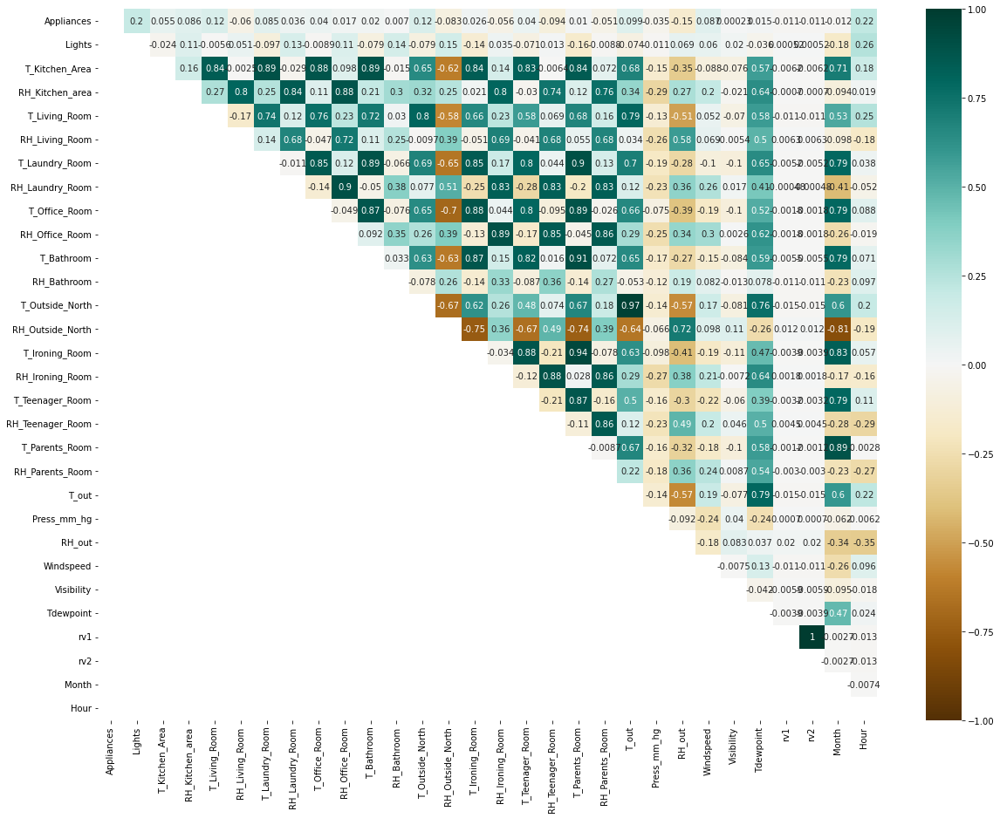

In [29]:
plt.figure(figsize= (20,15))
mask = np.tril(np.ones_like(df_1.corr(), dtype=np.bool))
sns.heatmap(df_1.corr(), cmap='BrBG', mask=mask, vmin=-1, vmax=1, annot=True)
plt.show()

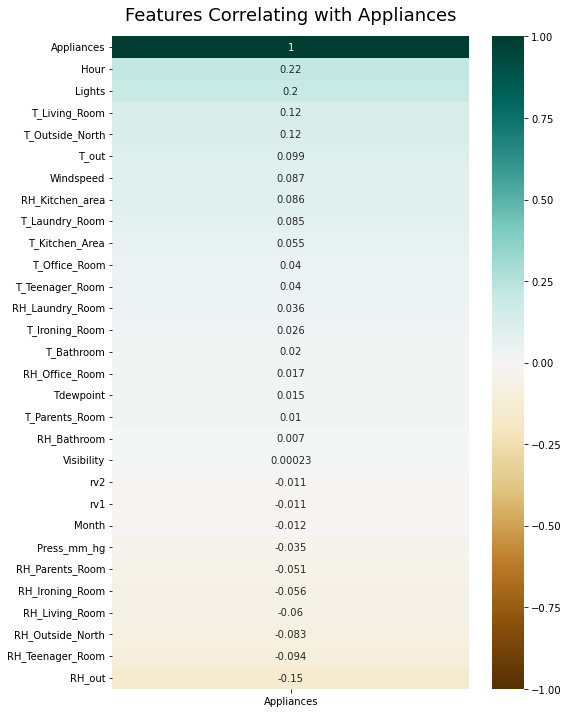

In [30]:
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(df_1.corr()[['Appliances']].sort_values(by='Appliances', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Features Correlating with Appliances', fontdict={'fontsize':18}, pad=16);

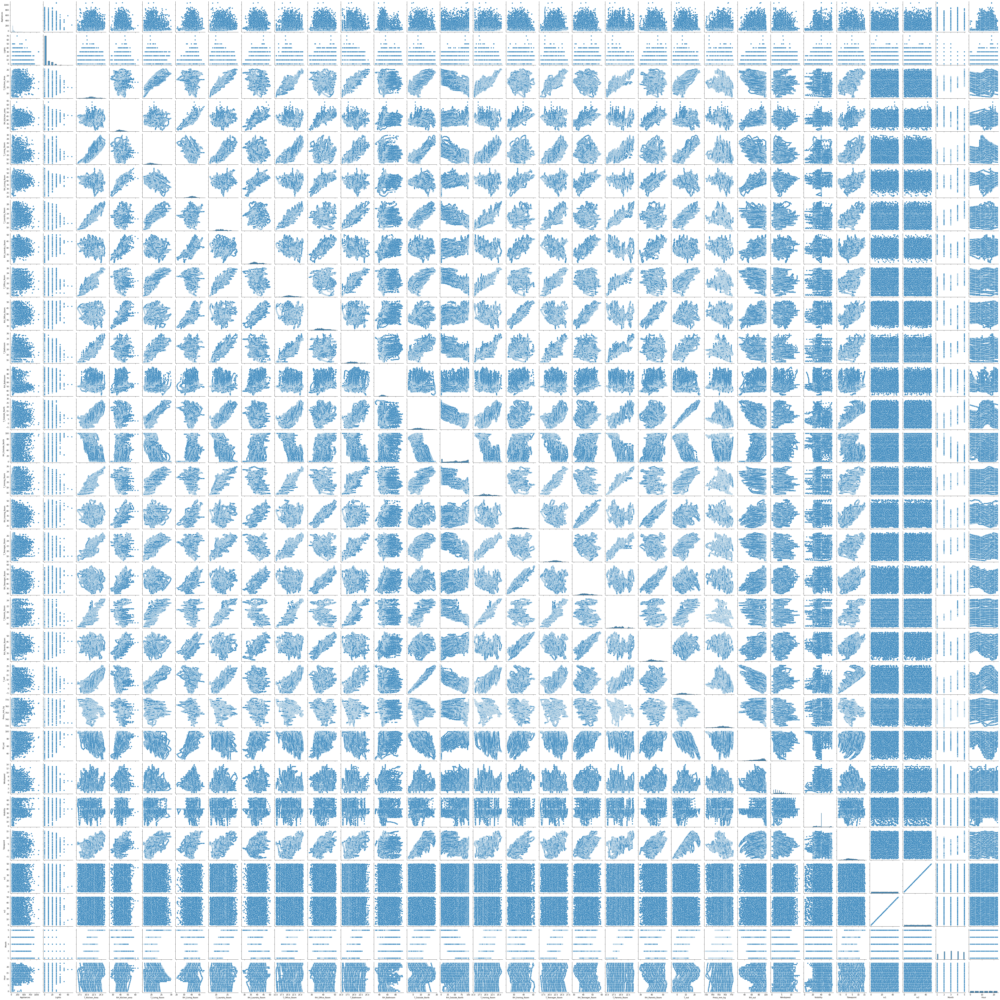

In [32]:
sns.pairplot(df_1)